# Creating SFrame & Training Object Detector in TuriCreate

This notebook demonstrates how to create an **SFrame** from **annotated images** which is used to train an **object detection model** using **TuriCreate**. <br> The resulting detector is exported to **CoreML** and implemented in LeftOverHero (Swift app https://github.com/svena33/LeftoverHero).

In [1]:
#import packages
import pandas as pd
import numpy as np
import os
from PIL import Image
import turicreate as tc

In [2]:
#use full width of display
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

### Load Data

We assume that the data (images + annotations) is stored in 'data/'. <br>
The original dataset is not uploaded since I don't posses the distribution rights to them.

For example: <br>
Image:
'data/pic_onion_001.jpg' <br>
Annotation: 
'data/pic_onion_001.txt'
<br>

#### Annotation structure:

class x  y width height <br>
0 0.189167 0.431085 0.131667 0.261975
<br>
float values relative to width and height of image, it can be equal from 0.0 to 1.0


In [3]:
data_path = r'data/' #profile data path
#label0 is onion
#label1 is tomato
classArray = ["onion", "tomato"]

In [4]:
#get all the file names (both .jpg & txt) 
for (idx,entry) in enumerate(os.scandir(data_path)):
    if entry.is_file():
        idx,entry.name

### Data wrangling
#### Helper Functions

In [5]:
def getTxt(imageP):
    pre, ext = os.path.splitext(imageP)
    txtfile = pre+".txt"
    return txtfile

def getImageDimension(imageP):
    filePath = imageP
    img = Image.open(filePath)
    width, height = img.size
    return (width,height)

def getLabel(classNumber):
    ##Link classnumber in .txt to class label (e.g. class 0 => label 'onion')
    ##Order matters
    return classArray[classNumber]


#normcenterX...normHeight are all normalized float values between 0-1
#See reference [1]
def getCoordinates(imageWidth, imageHeight, normcenterX, normcenterY, normWidth, normHeight):
    boxCenterX = imageWidth*normcenterX
    boxWidth = imageWidth*normWidth
    
    boxCenterY = imageHeight*normcenterY
    boxHeigth = imageHeight*normHeight
    return ({'x': int(boxCenterX), 'width': int(boxWidth),'y': int(boxCenterY), 'height': int(boxHeigth)})
    

#create annotation in format e.g. {label: "onion", "coordinates": {'x': 340, 'width': 237, 'y': 440, 'height': 268}}
def createAnnotation(entry, i_width, i_height):
    label = getLabel(int(entry[0]))
    _, centerX, centerY, nWidth, nHeight = entry.split()

    coordinates = getCoordinates(i_width, i_height, float(centerX), float(centerY), float(nWidth), float(nHeight))
    return ({'label': label, 'coordinates': coordinates})

#generate the annotations column for an image (e.g. [{label: ..., "coordinates": ...}, ..., {label: ..., "coordinates": ...}])
def generateExtraColumns(imagePath):
    img_width, img_height = getImageDimension(imagePath)
    #get the txt file associated with this image
    txt_file = getTxt(imagePath)
    
    annotation = []
    if os.path.isfile(txt_file):
        #File exist
        with open(txt_file) as f:
            lines = [line.rstrip('\n') for line in f]
            for entry in lines:
                annotation.append(createAnnotation(entry, img_width, img_height))
    else:
        #File does not exist
        pass
    
    return annotation

### Create SFrame for TuriCreate 

In [6]:
#Loads images from a directory.
data = tc.image_analysis.load_images(data_path, with_path=True)

In [7]:
#generate the annotations column for every image
data['annotations'] = data['path'].apply(generateExtraColumns)

#add a column which visualizes bounding boxes (ground truth or predictions) by returning annotated copies of the images.
data['image_with_ground_truth'] = tc.object_detector.util.draw_bounding_boxes(data["image"], data["annotations"])

/Users/svenarends/anaconda3/lib/python3.7/site-packages/turicreate/visualization/_plot.py:376: UserWarning: Displaying only the first 100 rows.
  warnings.warn('Displaying only the first {} rows.'.format(maximum_rows))


,path,image,annotations,image_with_ground_truth
0,data/pic_onion_001.jpg,,"[{'label': 'onion', 'coordinates': {'x': 340, 'width': 237, 'y': 440, 'height': 268}}, {'label': 'onion', 'coordinates': {'x': 774, 'width': 295, 'y': 446, 'height': 232}}, {'label': 'onion', 'coordinates': {'x': 1266, 'width': 318, 'y': 819, 'height': 293}}, {'label': 'onion', 'coordinates': {'x': 1053, 'width': 275, 'y': 357, 'height': 278}}, {'label': 'onion', 'coordinates': {'x': 763, 'width': 307, 'y': 213, 'height': 272}}, {'label': 'onion', 'coordinates': {'x': 1467, 'width': 282, 'y': 717, 'height': 232}}, {'label': 'onion', 'coordinates': {'x': 1096, 'width': 243, 'y': 712, 'height': 243}}, {'label': 'onion', 'coordinates': {'x': 486, 'width': 214, 'y': 280, 'height': 179}}]",
1,data/pic_onion_002.jpg,,"[{'label': 'onion', 'coordinates': {'x': 582, 'width': 1154, 'y': 611, 'height': 1108}}, {'label': 'onion', 'coordinates': {'x': 1273, 'width': 1021, 'y': 1216, 'height': 1115}}]",
2,data/pic_onion_003.jpeg,,"[{'label': 'onion', 'coordinates': {'x': 69, 'width': 136, 'y': 71, 'height': 141}}, {'label': 'onion', 'coordinates': {'x': 167, 'width': 130, 'y': 116, 'height': 126}}, {'label': 'onion', 'coordinates': {'x': 276, 'width': 141, 'y': 75, 'height': 136}}]",
3,data/pic_onion_004.jpg,,"[{'label': 'onion', 'coordinates': {'x': 267, 'width': 228, 'y': 220, 'height': 207}}, {'label': 'onion', 'coordinates': {'x': 148, 'width': 156, 'y': 394, 'height': 112}}, {'label': 'onion', 'coordinates': {'x': 504, 'width': 176, 'y': 189, 'height': 184}}, {'label': 'onion', 'coordinates': {'x': 640, 'width': 174, 'y': 363, 'height': 139}}, {'label': 'onion', 'coordinates': {'x': 449, 'width': 174, 'y': 383, 'height': 133}}]",
4,data/pic_onion_007.jpg,,"[{'label': 'onion', 'coordinates': {'x': 856, 'width': 806, 'y': 384, 'height': 711}}, {'label': 'onion', 'coordinates': {'x': 1771, 'width': 702, 'y': 517, 'height': 717}}, {'label': 'onion', 'coordinates': {'x': 1286, 'width': 716, 'y': 1100, 'height': 627}}]",
5,data/pic_onion_008.png,,"[{'label': 'onion', 'coordinates': {'x': 238, 'width': 241, 'y': 148, 'height': 274}}]",
6,data/pic_onion_009.jpg,,"[{'label': 'onion', 'coordinates': {'x': 249, 'width': 428, 'y': 532, 'height': 426}}, {'label': 'onion', 'coordinates': {'x': 882, 'width': 436, 'y': 651, 'height': 364}}, {'label': 'onion', 'coordinates': {'x': 1225, 'width': 422, 'y': 388, 'height': 364}}, {'label': 'onion', 'coordinates': {'x': 664, 'width': 424, 'y': 399, 'height': 313}}, {'label': 'onion', 'coordinates': {'x': 947, 'width': 325, 'y': 176, 'height': 276}}]",
7,data/pic_onion_012.jpg,,"[{'label': 'onion', 'coordinates': {'x': 77, 'width': 125, 'y': 200, 'height': 152}}, {'label': 'onion', 'coordinates': {'x': 221, 'width': 158, 'y': 199, 'height': 153}}, {'label': 'onion', 'coordinates': {'x': 124, 'width': 186, 'y': 79, 'height': 153}}]",
8,data/pic_onion_013.jpg,,"[{'label': 'onion', 'coordinates': {'x': 309, 'width': 330, 'y': 586, 'height': 195}}, {'label': 'onion', 'coordinates': {'x': 949, 'width': 300, 'y': 219, 'height': 331}}, {'label': 'onion', 'coordinates': {'x': 485, 'width': 231, 'y': 382, 'height': 249}}, {'label': 'onion', 'coordinates': {'x': 293, 'width': 253, 'y': 237, 'height': 254}}, {'label': 'onion', 'coordinates': {'x': 881, 'width': 303, 'y': 543, 'height': 245}}, {'label': 'onion', 'coordinates': {'x': 514, 'width': 242, 'y': 593, 'height': 217}}]",
9,data/pic_onion_015.jpg,,"[{'label': 'onion', 'coordinates': {'x': 738, 'width': 1372, 'y': 798, 'height': 1390}}]",

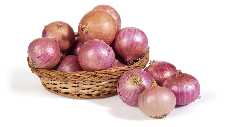
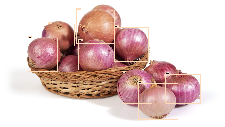
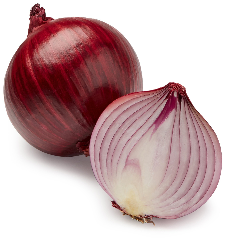
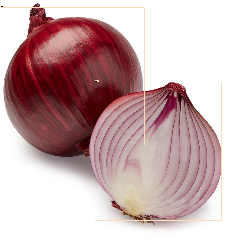
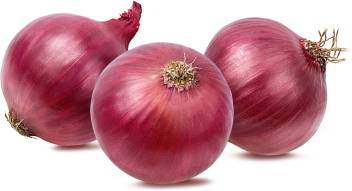
...
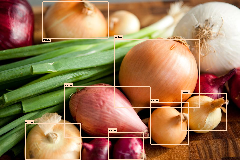
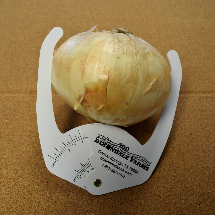
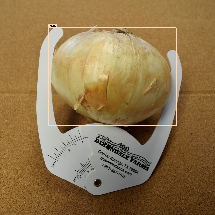
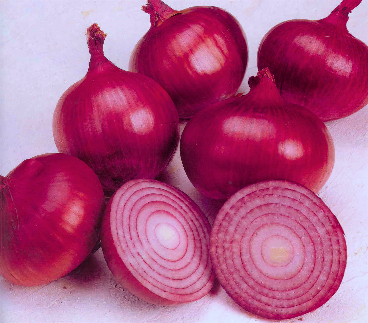
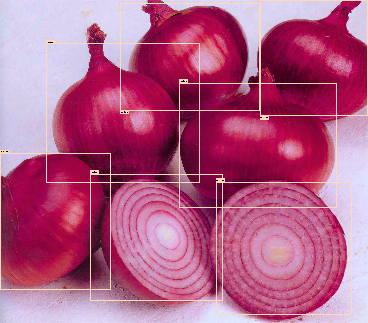

In [8]:
#explore the sFrame
data.explore()

In [9]:
# Save the data as SFrame for future use
data.save('TomatoOnionTrainFrame.sframe')


### Training Model

In [13]:
# Load the data from the sframe
data = tc.SFrame('TomatoOnionTrainFrame.sframe')

# Make a train-test split
train_data, test_data = data.random_split(0.8)

# Automatically picks the right model based on your data.
model = tc.object_detector.create(train_data, feature='image', annotations='annotations', max_iterations=600)

Using GPU to create model (NVIDIA GeForce GT 750M)

Setting 'batch_size' to 16

+--------------+--------------+--------------+

| Iteration    | Loss         | Elapsed Time |

+--------------+--------------+--------------+

| 1            | 7.63871      | 6.16s        |

| 2            | 7.64323      | 11.24s       |

| 3            | 7.57792      | 16.06s       |

| 4            | 7.5406       | 20.89s       |

| 5            | 7.5728       | 25.70s       |

| 6            | 7.34497      | 30.52s       |

| 7            | 7.0909       | 35.34s       |

| 8            | 6.94388      | 40.16s       |

| 9            | 6.7704       | 44.98s       |

| 10           | 7.04074      | 49.80s       |

| 11           | 7.1071       | 54.60s       |

| 12           | 7.22409      | 59.42s       |

| 13           | 7.41981      | 1m 4s        |

| 14           | 7.43263      | 1m 9s        |

| 15           | 7.56511      | 1m 13s       |

| 16           | 7.56734      | 1m 18s       |

| 17           | 7.4713       | 1m 23s       |

| 18           | 7.47825      | 1m 28s       |

| 19           | 7.44479      | 1m 33s       |

| 20           | 7.50212      | 1m 43s       |

| 21           | 7.35159      | 1m 44s       |

| 22           | 7.4329       | 1m 54s       |

| 23           | 7.41998      | 1m 54s       |

| 24           | 7.32555      | 2m 4s        |

| 25           | 7.13668      | 2m 5s        |

| 26           | 7.21357      | 2m 15s       |

| 27           | 7.1469       | 2m 16s       |

| 28           | 7.08156      | 2m 26s       |

| 29           | 6.90575      | 2m 26s       |

| 30           | 6.77045      | 2m 36s       |

| 31           | 6.77091      | 2m 37s       |

| 32           | 6.8186       | 2m 47s       |

| 33           | 6.72792      | 2m 47s       |

| 34           | 6.76978      | 2m 57s       |

| 35           | 6.67225      | 2m 58s       |

| 36           | 6.68229      | 3m 3s        |

| 37           | 6.67651      | 3m 13s       |

| 38           | 6.62593      | 3m 13s       |

| 39           | 6.5434       | 3m 18s       |

| 40           | 6.54531      | 3m 23s       |

| 41           | 6.49868      | 3m 28s       |

| 42           | 6.44559      | 3m 33s       |

| 43           | 6.43246      | 3m 38s       |

| 44           | 6.38934      | 3m 43s       |

| 45           | 6.30258      | 3m 47s       |

| 46           | 6.15779      | 3m 52s       |

| 47           | 5.99934      | 3m 57s       |

| 48           | 6.05907      | 4m 2s        |

| 49           | 5.93358      | 4m 7s        |

| 50           | 5.86952      | 4m 11s       |

| 51           | 5.82786      | 4m 16s       |

| 52           | 5.88961      | 4m 21s       |

| 53           | 5.75767      | 4m 26s       |

| 54           | 5.6519       | 4m 37s       |

| 55           | 5.73264      | 4m 37s       |

| 56           | 5.73666      | 4m 48s       |

| 57           | 5.64998      | 4m 48s       |

| 58           | 5.79297      | 4m 58s       |

| 59           | 5.90759      | 4m 58s       |

| 60           | 5.76164      | 5m 9s        |

| 61           | 5.58997      | 5m 9s        |

| 62           | 5.61197      | 5m 19s       |

| 63           | 5.57214      | 5m 20s       |

| 64           | 5.53271      | 5m 30s       |

| 65           | 5.48303      | 5m 30s       |

| 66           | 5.40424      | 5m 40s       |

| 67           | 5.39858      | 5m 41s       |

| 68           | 5.62214      | 5m 51s       |

| 69           | 5.49405      | 5m 51s       |

| 70           | 5.5778       | 6m 1s        |

| 71           | 5.53656      | 6m 2s        |

| 72           | 5.62503      | 6m 12s       |

| 73           | 5.56385      | 6m 13s       |

| 74           | 5.50195      | 6m 23s       |

| 75           | 5.33549      | 6m 23s       |

| 76           | 5.36892      | 6m 33s       |

| 77           | 5.25977      | 6m 34s       |

| 78           | 5.16985      | 6m 44s       |

| 79           | 5.19         | 6m 44s       |

| 80           | 5.20212      | 6m 55s       |

| 81           | 5.25413      | 6m 55s       |

| 82           | 5.21067      | 7m 5s        |

| 83           | 5.19206      | 7m 6s        |

| 84           | 5.01574      | 7m 16s       |

| 85           | 5.08963      | 7m 16s       |

| 86           | 5.07462      | 7m 26s       |

| 87           | 5.11597      | 7m 27s       |

| 88           | 5.23495      | 7m 37s       |

| 89           | 5.18496      | 7m 37s       |

| 90           | 5.04556      | 7m 47s       |

| 91           | 5.02984      | 7m 48s       |

| 92           | 4.97949      | 7m 53s       |

| 93           | 5.0197       | 7m 58s       |

| 94           | 4.95418      | 8m 3s        |

| 95           | 5.13672      | 8m 8s        |

| 96           | 5.01467      | 8m 12s       |

| 97           | 4.91533      | 8m 17s       |

| 98           | 4.92714      | 8m 22s       |

| 99           | 5.26167      | 8m 27s       |

| 100          | 5.24561      | 8m 32s       |

| 101          | 5.11919      | 8m 37s       |

| 102          | 5.02863      | 8m 42s       |

| 103          | 4.99169      | 8m 47s       |

| 104          | 4.9688       | 8m 51s       |

| 105          | 4.93695      | 8m 56s       |

| 106          | 4.89853      | 9m 1s        |

| 107          | 4.96717      | 9m 6s        |

| 108          | 4.84617      | 9m 11s       |

| 109          | 4.72905      | 9m 15s       |

| 110          | 4.64958      | 9m 20s       |

| 111          | 4.69089      | 9m 25s       |

| 112          | 4.56198      | 9m 30s       |

| 113          | 4.6275       | 9m 35s       |

| 114          | 4.49695      | 9m 39s       |

| 115          | 4.48151      | 9m 44s       |

| 116          | 4.46995      | 9m 50s       |

| 117          | 4.4999       | 9m 55s       |

| 118          | 4.68306      | 10m 0s       |

| 119          | 4.60709      | 10m 4s       |

| 120          | 4.54634      | 10m 9s       |

| 121          | 4.4626       | 10m 14s      |

| 122          | 4.52936      | 10m 19s      |

| 123          | 4.59084      | 10m 24s      |

| 124          | 4.53475      | 10m 29s      |

| 125          | 4.49014      | 10m 39s      |

| 126          | 4.41573      | 10m 40s      |

| 127          | 4.34442      | 10m 50s      |

| 128          | 4.41682      | 10m 51s      |

| 129          | 4.31298      | 10m 56s      |

| 130          | 4.30789      | 11m 1s       |

| 131          | 4.28762      | 11m 11s      |

| 132          | 4.35784      | 11m 12s      |

| 133          | 4.38496      | 11m 22s      |

| 134          | 4.45796      | 11m 22s      |

| 135          | 4.31587      | 11m 33s      |

| 136          | 4.2702       | 11m 33s      |

| 137          | 4.25269      | 11m 43s      |

| 138          | 4.18849      | 11m 43s      |

| 139          | 4.25284      | 11m 54s      |

| 140          | 4.3115       | 11m 54s      |

| 141          | 4.30875      | 12m 4s       |

| 142          | 4.20228      | 12m 5s       |

| 143          | 4.2566       | 12m 15s      |

| 144          | 4.3201       | 12m 15s      |

| 145          | 4.29301      | 12m 25s      |

| 146          | 4.27761      | 12m 26s      |

| 147          | 4.24121      | 12m 31s      |

| 148          | 4.25792      | 12m 36s      |

| 149          | 4.23415      | 12m 41s      |

| 150          | 4.18892      | 12m 45s      |

| 151          | 4.19592      | 12m 50s      |

| 152          | 4.26911      | 12m 55s      |

| 153          | 4.25134      | 13m 0s       |

| 154          | 4.20242      | 13m 5s       |

| 155          | 4.24821      | 13m 10s      |

| 156          | 4.40647      | 13m 14s      |

| 157          | 4.39341      | 13m 19s      |

| 158          | 4.39906      | 13m 24s      |

| 159          | 4.41124      | 13m 29s      |

| 160          | 4.4729       | 13m 34s      |

| 161          | 4.56828      | 13m 39s      |

| 162          | 4.42759      | 13m 44s      |

| 163          | 4.39462      | 13m 48s      |

| 164          | 4.50527      | 13m 53s      |

| 165          | 4.41232      | 13m 59s      |

| 166          | 4.31082      | 14m 9s       |

| 167          | 4.19251      | 14m 9s       |

| 168          | 4.09442      | 14m 19s      |

| 169          | 3.99499      | 14m 20s      |

| 170          | 3.98547      | 14m 30s      |

| 171          | 4.01938      | 14m 30s      |

| 172          | 4.03245      | 14m 41s      |

| 173          | 4.04855      | 14m 41s      |

| 174          | 4.01186      | 14m 51s      |

| 175          | 3.98029      | 14m 51s      |

| 176          | 4.02732      | 15m 2s       |

| 177          | 4.10112      | 15m 2s       |

| 178          | 4.27916      | 15m 7s       |

| 179          | 4.28346      | 15m 12s      |

| 180          | 4.19211      | 15m 17s      |

| 181          | 4.30687      | 15m 21s      |

| 182          | 4.22788      | 15m 26s      |

| 183          | 4.187        | 15m 31s      |

| 184          | 4.10265      | 15m 36s      |

| 185          | 4.24204      | 15m 41s      |

| 186          | 4.24813      | 15m 46s      |

| 187          | 4.34367      | 15m 50s      |

| 188          | 4.29274      | 15m 55s      |

| 189          | 4.29089      | 16m 0s       |

| 190          | 4.22837      | 16m 5s       |

| 191          | 4.19554      | 16m 10s      |

| 192          | 4.15594      | 16m 15s      |

| 193          | 4.12213      | 16m 19s      |

| 194          | 4.13832      | 16m 24s      |

| 195          | 4.16178      | 16m 29s      |

| 196          | 4.14076      | 16m 34s      |

| 197          | 4.13989      | 16m 39s      |

| 198          | 4.19989      | 16m 44s      |

| 199          | 4.09893      | 16m 49s      |

| 200          | 4.10359      | 16m 53s      |

| 201          | 3.97649      | 16m 58s      |

| 202          | 3.91418      | 17m 3s       |

| 203          | 3.82835      | 17m 8s       |

| 204          | 3.75994      | 17m 13s      |

| 205          | 3.90878      | 17m 17s      |

| 206          | 3.82192      | 17m 22s      |

| 207          | 3.87798      | 17m 27s      |

| 208          | 3.76918      | 17m 32s      |

| 209          | 3.88058      | 17m 37s      |

| 210          | 4.10516      | 17m 41s      |

| 211          | 4.26329      | 17m 46s      |

| 212          | 4.22034      | 17m 51s      |

| 213          | 4.17213      | 17m 56s      |

| 214          | 4.17         | 18m 1s       |

| 215          | 4.07128      | 18m 6s       |

| 216          | 4.07734      | 18m 11s      |

| 217          | 4.13108      | 18m 15s      |

| 218          | 4.21848      | 18m 20s      |

| 219          | 4.1367       | 18m 25s      |

| 220          | 3.9886       | 18m 30s      |

| 221          | 3.95989      | 18m 35s      |

| 222          | 3.84165      | 18m 40s      |

| 223          | 3.82629      | 18m 45s      |

| 224          | 3.83636      | 18m 50s      |

| 225          | 3.74869      | 18m 55s      |

| 226          | 3.70719      | 18m 59s      |

| 227          | 3.71537      | 19m 4s       |

| 228          | 3.84409      | 19m 9s       |

| 229          | 3.91298      | 19m 14s      |

| 230          | 4.18022      | 19m 19s      |

| 231          | 4.11551      | 19m 24s      |

| 232          | 4.03513      | 19m 28s      |

| 233          | 3.99983      | 19m 33s      |

| 234          | 3.93574      | 19m 38s      |

| 235          | 3.92797      | 19m 43s      |

| 236          | 3.91282      | 19m 48s      |

| 237          | 3.94875      | 19m 53s      |

| 238          | 3.86988      | 19m 58s      |

| 239          | 3.75377      | 20m 3s       |

| 240          | 3.78802      | 20m 13s      |

| 241          | 3.79432      | 20m 14s      |

| 242          | 3.7074       | 20m 24s      |

| 243          | 3.82013      | 20m 24s      |

| 244          | 3.85265      | 20m 35s      |

| 245          | 3.86955      | 20m 35s      |

| 246          | 3.81785      | 20m 45s      |

| 247          | 3.9003       | 20m 45s      |

| 248          | 3.81043      | 20m 56s      |

| 249          | 3.78185      | 20m 56s      |

| 250          | 3.72068      | 21m 6s       |

| 251          | 3.77912      | 21m 7s       |

| 252          | 3.94995      | 21m 17s      |

| 253          | 3.99736      | 21m 17s      |

| 254          | 3.92745      | 21m 27s      |

| 255          | 3.80523      | 21m 28s      |

| 256          | 3.76431      | 21m 38s      |

| 257          | 3.69116      | 21m 38s      |

| 258          | 3.80263      | 21m 49s      |

| 259          | 3.82565      | 21m 49s      |

| 260          | 3.95794      | 21m 59s      |

| 261          | 3.83321      | 22m 0s       |

| 262          | 3.8692       | 22m 10s      |

| 263          | 3.8254       | 22m 10s      |

| 264          | 3.77566      | 22m 20s      |

| 265          | 3.74539      | 22m 21s      |

| 266          | 3.76478      | 22m 31s      |

| 267          | 3.8629       | 22m 31s      |

| 268          | 3.85575      | 22m 41s      |

| 269          | 3.8063       | 22m 42s      |

| 270          | 3.77722      | 22m 52s      |

| 271          | 3.83422      | 22m 52s      |

| 272          | 3.92184      | 23m 2s       |

| 273          | 3.93534      | 23m 3s       |

| 274          | 3.88419      | 23m 13s      |

| 275          | 3.90974      | 23m 13s      |

| 276          | 3.78602      | 23m 23s      |

| 277          | 3.66604      | 23m 24s      |

| 278          | 3.64194      | 23m 34s      |

| 279          | 3.70304      | 23m 34s      |

| 280          | 3.65568      | 23m 44s      |

| 281          | 3.67184      | 23m 45s      |

| 282          | 3.69388      | 23m 55s      |

| 283          | 3.74815      | 23m 55s      |

| 284          | 3.73881      | 24m 6s       |

| 285          | 3.81006      | 24m 6s       |

| 286          | 3.73496      | 24m 16s      |

| 287          | 3.63795      | 24m 16s      |

| 288          | 3.63705      | 24m 27s      |

| 289          | 3.62617      | 24m 27s      |

| 290          | 3.72858      | 24m 37s      |

| 291          | 3.77231      | 24m 38s      |

| 292          | 3.68794      | 24m 48s      |

| 293          | 3.66756      | 24m 48s      |

| 294          | 3.62676      | 24m 58s      |

| 295          | 3.61521      | 24m 59s      |

| 296          | 3.65679      | 25m 9s       |

| 297          | 3.70445      | 25m 9s       |

| 298          | 3.6795       | 25m 19s      |

| 299          | 3.78849      | 25m 20s      |

| 300          | 3.7445       | 25m 30s      |

| 301          | 3.76258      | 25m 30s      |

| 302          | 3.81356      | 25m 40s      |

| 303          | 3.79466      | 25m 41s      |

| 304          | 3.7963       | 25m 51s      |

| 305          | 3.70929      | 25m 51s      |

| 306          | 3.67894      | 26m 2s       |

| 307          | 3.60978      | 26m 2s       |

| 308          | 3.70855      | 26m 12s      |

| 309          | 3.59241      | 26m 12s      |

| 310          | 3.52617      | 26m 23s      |

| 311          | 3.4373       | 26m 23s      |

| 312          | 3.43638      | 26m 33s      |

| 313          | 3.3682       | 26m 34s      |

| 314          | 3.33235      | 26m 44s      |

| 315          | 3.34469      | 26m 44s      |

| 316          | 3.36549      | 26m 54s      |

| 317          | 3.44189      | 26m 55s      |

| 318          | 3.30131      | 27m 5s       |

| 319          | 3.30882      | 27m 5s       |

| 320          | 3.47611      | 27m 16s      |

| 321          | 3.56833      | 27m 16s      |

| 322          | 3.59888      | 27m 26s      |

| 323          | 3.61757      | 27m 27s      |

| 324          | 3.59259      | 27m 37s      |

| 325          | 3.59957      | 27m 37s      |

| 326          | 3.59718      | 27m 47s      |

| 327          | 3.56211      | 27m 48s      |

| 328          | 3.51795      | 27m 58s      |

| 329          | 3.51334      | 27m 58s      |

| 330          | 3.55072      | 28m 9s       |

| 331          | 3.5082       | 28m 9s       |

| 332          | 3.49404      | 28m 19s      |

| 333          | 3.5126       | 28m 20s      |

| 334          | 3.50436      | 28m 30s      |

| 335          | 3.64176      | 28m 30s      |

| 336          | 3.63963      | 28m 40s      |

| 337          | 3.66785      | 28m 41s      |

| 338          | 3.71351      | 28m 51s      |

| 339          | 3.6005       | 28m 51s      |

| 340          | 3.58929      | 29m 1s       |

| 341          | 3.54902      | 29m 2s       |

| 342          | 3.52034      | 29m 12s      |

| 343          | 3.5203       | 29m 12s      |

| 344          | 3.47601      | 29m 22s      |

| 345          | 3.46173      | 29m 23s      |

| 346          | 3.42756      | 29m 33s      |

| 347          | 3.34645      | 29m 34s      |

| 348          | 3.32541      | 29m 39s      |

| 349          | 3.25249      | 29m 44s      |

| 350          | 3.30375      | 29m 48s      |

| 351          | 3.26531      | 29m 53s      |

| 352          | 3.19495      | 29m 58s      |

| 353          | 3.40321      | 30m 3s       |

| 354          | 3.50007      | 30m 8s       |

| 355          | 3.4255       | 30m 12s      |

| 356          | 3.49436      | 30m 17s      |

| 357          | 3.60319      | 30m 22s      |

| 358          | 3.54683      | 30m 27s      |

| 359          | 3.54559      | 30m 32s      |

| 360          | 3.43166      | 30m 37s      |

| 361          | 3.44309      | 30m 41s      |

| 362          | 3.46021      | 30m 46s      |

| 363          | 3.48865      | 30m 51s      |

| 364          | 3.38737      | 30m 56s      |

| 365          | 3.32764      | 31m 1s       |

| 366          | 3.28225      | 31m 5s       |

| 367          | 3.28285      | 31m 10s      |

| 368          | 3.22767      | 31m 15s      |

| 369          | 3.18535      | 31m 20s      |

| 370          | 3.20583      | 31m 25s      |

| 371          | 3.21359      | 31m 30s      |

| 372          | 3.20535      | 31m 34s      |

| 373          | 3.24368      | 31m 39s      |

| 374          | 3.39636      | 31m 44s      |

| 375          | 3.46865      | 31m 49s      |

| 376          | 3.34723      | 31m 54s      |

| 377          | 3.29844      | 31m 58s      |

| 378          | 3.26866      | 32m 3s       |

| 379          | 3.27717      | 32m 8s       |

| 380          | 3.2969       | 32m 13s      |

| 381          | 3.33341      | 32m 18s      |

| 382          | 3.32689      | 32m 23s      |

| 383          | 3.37861      | 32m 27s      |

| 384          | 3.35608      | 32m 32s      |

| 385          | 3.32461      | 32m 37s      |

| 386          | 3.35246      | 32m 42s      |

| 387          | 3.40163      | 32m 47s      |

| 388          | 3.38504      | 32m 52s      |

| 389          | 3.29442      | 32m 56s      |

| 390          | 3.25121      | 33m 1s       |

| 391          | 3.19713      | 33m 6s       |

| 392          | 3.14745      | 33m 11s      |

| 393          | 3.202        | 33m 16s      |

| 394          | 3.2188       | 33m 21s      |

| 395          | 3.18511      | 33m 25s      |

| 396          | 3.23668      | 33m 30s      |

| 397          | 3.27952      | 33m 35s      |

| 398          | 3.27857      | 33m 40s      |

| 399          | 3.2414       | 33m 45s      |

| 400          | 3.20854      | 33m 49s      |

| 401          | 3.16819      | 33m 54s      |

| 402          | 3.19293      | 33m 59s      |

| 403          | 3.15675      | 34m 4s       |

| 404          | 3.16784      | 34m 9s       |

| 405          | 3.11349      | 34m 14s      |

| 406          | 3.15954      | 34m 18s      |

| 407          | 3.09189      | 34m 23s      |

| 408          | 3.05049      | 34m 28s      |

| 409          | 2.98294      | 34m 33s      |

| 410          | 2.93038      | 34m 38s      |

| 411          | 2.93816      | 34m 43s      |

| 412          | 3.04846      | 34m 47s      |

| 413          | 3.10257      | 34m 52s      |

| 414          | 3.06788      | 34m 57s      |

| 415          | 3.02868      | 35m 2s       |

| 416          | 2.99947      | 35m 7s       |

| 417          | 3.03253      | 35m 11s      |

| 418          | 3.01138      | 35m 16s      |

| 419          | 2.96496      | 35m 21s      |

| 420          | 3.15198      | 35m 26s      |

| 421          | 3.23849      | 35m 31s      |

| 422          | 3.28627      | 35m 36s      |

| 423          | 3.26115      | 35m 40s      |

| 424          | 3.2213       | 35m 45s      |

| 425          | 3.16167      | 35m 50s      |

| 426          | 3.14193      | 35m 55s      |

| 427          | 3.22245      | 36m 0s       |

| 428          | 3.22787      | 36m 5s       |

| 429          | 3.20357      | 36m 9s       |

| 430          | 3.30644      | 36m 14s      |

| 431          | 3.19816      | 36m 19s      |

| 432          | 3.20235      | 36m 24s      |

| 433          | 3.27397      | 36m 29s      |

| 434          | 3.36394      | 36m 34s      |

| 435          | 3.44542      | 36m 38s      |

| 436          | 3.39856      | 36m 43s      |

| 437          | 3.37592      | 36m 48s      |

| 438          | 3.42235      | 36m 53s      |

| 439          | 3.34411      | 36m 58s      |

| 440          | 3.30085      | 37m 3s       |

| 441          | 3.3169       | 37m 7s       |

| 442          | 3.34422      | 37m 12s      |

| 443          | 3.32193      | 37m 17s      |

| 444          | 3.30219      | 37m 22s      |

| 445          | 3.22709      | 37m 27s      |

| 446          | 3.24668      | 37m 32s      |

| 447          | 3.16262      | 37m 36s      |

| 448          | 3.12474      | 37m 41s      |

| 449          | 3.08498      | 37m 46s      |

| 450          | 3.11307      | 37m 51s      |

| 451          | 3.07889      | 37m 56s      |

| 452          | 3.05451      | 38m 0s       |

| 453          | 3.17069      | 38m 5s       |

| 454          | 3.13937      | 38m 10s      |

| 455          | 3.12249      | 38m 15s      |

| 456          | 3.1722       | 38m 20s      |

| 457          | 3.06971      | 38m 25s      |

| 458          | 3.1605       | 38m 30s      |

| 459          | 3.14769      | 38m 40s      |

| 460          | 3.20696      | 38m 41s      |

| 461          | 3.16823      | 38m 51s      |

| 462          | 3.19739      | 38m 51s      |

| 463          | 3.1809       | 39m 1s       |

| 464          | 3.27208      | 39m 2s       |

| 465          | 3.26623      | 39m 12s      |

| 466          | 3.19113      | 39m 13s      |

| 467          | 3.09582      | 39m 23s      |

| 468          | 3.1657       | 39m 23s      |

| 469          | 3.22847      | 39m 28s      |

| 470          | 3.20155      | 39m 33s      |

| 471          | 3.18842      | 39m 38s      |

| 472          | 3.21319      | 39m 43s      |

| 473          | 3.23417      | 39m 52s      |

| 474          | 3.27432      | 1h 9m        |

| 475          | 3.18439      | 1h 9m        |

| 476          | 3.2876       | 1h 10m       |

| 477          | 3.21045      | 1h 13m       |

| 478          | 3.12525      | 1h 13m       |

| 479          | 3.18807      | 1h 13m       |

| 480          | 3.17673      | 1h 13m       |

| 481          | 3.1644       | 1h 13m       |

| 482          | 3.15595      | 1h 13m       |

| 483          | 3.12944      | 1h 13m       |

| 484          | 3.16543      | 1h 13m       |

| 485          | 3.2071       | 1h 14m       |

| 486          | 3.29131      | 1h 14m       |

| 487          | 3.23561      | 1h 14m       |

| 488          | 3.29953      | 1h 14m       |

| 489          | 3.29689      | 1h 14m       |

| 490          | 3.30063      | 1h 14m       |

| 491          | 3.23141      | 1h 14m       |

| 492          | 3.23701      | 1h 14m       |

| 493          | 3.15093      | 1h 14m       |

| 494          | 3.2524       | 1h 14m       |

| 495          | 3.2345       | 1h 14m       |

| 496          | 3.26661      | 1h 14m       |

| 497          | 3.13446      | 1h 15m       |

| 498          | 3.16967      | 1h 15m       |

| 499          | 3.23234      | 1h 15m       |

| 500          | 3.28932      | 1h 15m       |

| 501          | 3.28479      | 1h 15m       |

| 502          | 3.30157      | 1h 15m       |

| 503          | 3.22281      | 1h 15m       |

| 504          | 3.21087      | 1h 15m       |

| 505          | 3.14994      | 1h 15m       |

| 506          | 3.19105      | 1h 15m       |

| 507          | 3.29232      | 1h 15m       |

| 508          | 3.32319      | 1h 15m       |

| 509          | 3.20816      | 1h 15m       |

| 510          | 3.16657      | 1h 16m       |

| 511          | 3.15234      | 1h 16m       |

| 512          | 3.13861      | 1h 16m       |

| 513          | 3.22239      | 1h 16m       |

| 514          | 3.11625      | 1h 16m       |

| 515          | 3.10332      | 1h 16m       |

| 516          | 3.1159       | 1h 16m       |

| 517          | 3.08287      | 1h 16m       |

| 518          | 3.11851      | 1h 16m       |

| 519          | 3.25413      | 1h 16m       |

| 520          | 3.32518      | 1h 17m       |

| 521          | 3.2206       | 1h 17m       |

| 522          | 3.19095      | 1h 17m       |

| 523          | 3.31871      | 1h 17m       |

| 524          | 3.31991      | 1h 17m       |

| 525          | 3.39016      | 1h 17m       |

| 526          | 3.34531      | 1h 17m       |

| 527          | 3.29611      | 1h 17m       |

| 528          | 3.30558      | 1h 17m       |

| 529          | 3.16312      | 1h 17m       |

| 530          | 3.11258      | 1h 17m       |

| 531          | 3.10094      | 1h 17m       |

| 532          | 3.17437      | 1h 18m       |

| 533          | 3.0816       | 1h 18m       |

| 534          | 3.03682      | 1h 18m       |

| 535          | 3.01744      | 1h 18m       |

| 536          | 2.93357      | 1h 18m       |

| 537          | 2.85497      | 1h 18m       |

| 538          | 2.85787      | 1h 18m       |

| 539          | 2.99815      | 1h 18m       |

| 540          | 2.96523      | 1h 18m       |

| 541          | 3.00587      | 1h 18m       |

| 542          | 2.96849      | 1h 18m       |

| 543          | 3.01631      | 1h 18m       |

| 544          | 3.18899      | 1h 19m       |

| 545          | 3.13428      | 1h 19m       |

| 546          | 3.09737      | 1h 19m       |

| 547          | 3.07861      | 1h 19m       |

| 548          | 3.08851      | 1h 19m       |

| 549          | 3.1533       | 1h 19m       |

| 550          | 3.13189      | 1h 19m       |

| 551          | 3.04683      | 1h 19m       |

| 552          | 3.0526       | 1h 19m       |

| 553          | 3.19704      | 1h 19m       |

| 554          | 3.19302      | 1h 20m       |

| 555          | 3.19076      | 1h 20m       |

| 556          | 3.19687      | 1h 20m       |

| 557          | 3.32792      | 1h 20m       |

| 558          | 3.25713      | 1h 20m       |

| 559          | 3.22277      | 1h 20m       |

| 560          | 3.23475      | 1h 20m       |

| 561          | 3.21534      | 1h 20m       |

| 562          | 3.22118      | 1h 20m       |

| 563          | 3.18539      | 1h 20m       |

| 564          | 3.20239      | 1h 20m       |

| 565          | 3.146        | 1h 20m       |

| 566          | 3.03404      | 1h 21m       |

| 567          | 3.09872      | 1h 21m       |

| 568          | 3.1615       | 1h 21m       |

| 569          | 3.17081      | 1h 21m       |

| 570          | 3.08937      | 1h 21m       |

| 571          | 2.95908      | 1h 21m       |

| 572          | 2.91809      | 1h 21m       |

| 573          | 2.98398      | 1h 21m       |

| 574          | 3.00851      | 1h 21m       |

| 575          | 2.93006      | 1h 21m       |

| 576          | 2.98753      | 1h 21m       |

| 577          | 3.00693      | 1h 21m       |

| 578          | 2.97302      | 1h 22m       |

| 579          | 3.00336      | 1h 22m       |

| 580          | 2.94544      | 1h 22m       |

| 581          | 2.98168      | 1h 22m       |

| 582          | 2.97664      | 1h 22m       |

| 583          | 2.92183      | 1h 22m       |

| 584          | 2.95081      | 1h 22m       |

| 585          | 2.933        | 1h 22m       |

| 586          | 2.93168      | 1h 22m       |

| 587          | 2.91911      | 1h 22m       |

| 588          | 2.97069      | 1h 22m       |

| 589          | 2.96386      | 1h 22m       |

| 590          | 2.90662      | 1h 22m       |

| 591          | 2.87304      | 1h 23m       |

| 592          | 2.90552      | 1h 23m       |

| 593          | 2.91329      | 1h 23m       |

| 594          | 2.85106      | 1h 23m       |

| 595          | 2.81791      | 1h 23m       |

| 596          | 2.87636      | 1h 23m       |

| 597          | 2.8483       | 1h 23m       |

| 598          | 2.89418      | 1h 23m       |

| 599          | 2.83032      | 1h 23m       |

| 600          | 2.91641      | 1h 23m       |

+--------------+--------------+--------------+

#### Evaluate Model

In [14]:
# Mean average Precision
scores = model.evaluate(data)
print(scores['average_precision_50'])
print(scores['mean_average_precision_50'])

{'onion': 0.0010878939647227526, 'tomato': 0.0011846997076645494}
0.0011362968944013119


### Exporting Trained model

In [15]:
modelName = "TomatoOnion"
# Save the model for later use in Turi Create
# Important to save in case something after breaks the script
model.save(modelName + '.model')

# Export for use in CoreML
model.export_coreml(modelName.title() + 'Detector.mlmodel')

### References

[1] https://medium.com/@manivannan_data/how-to-train-yolov2-to-detect-custom-objects-9010df784f36 <br>
[2] https://apple.github.io/turicreate/docs/api/index.html